<a href="https://colab.research.google.com/github/fugugdeveloper/Brain-Tumor-Detection-and-Classification-using-Fine-Tuned-Resnet50-Model/blob/master/Brain_Tumor_Detection_and_Classification_Final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [5]:
from tensorflow import keras
from keras.callbacks import EarlyStopping,ReduceLROnPlateau,ModelCheckpoint,TensorBoard,LambdaCallback
from keras.layers import Input,Dropout, Dense,GlobalAveragePooling2D,BatchNormalization
from keras.models import Model
from keras.applications import ResNet50
import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import cv2
import pandas as pd
from tqdm import tqdm
from zipfile import ZipFile
from tensorflow.keras.models import load_model
from sklearn.metrics import classification_report, confusion_matrix
import io
import itertools
import os
import datetime
from sklearn.utils.class_weight import compute_class_weight
from sklearn.metrics import precision_score, recall_score, f1_score
from collections import Counter

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix,classification_report
from tensorflow.keras.optimizers import Adam
from sklearn.utils import shuffle
import matplotlib.pyplot as plt
import tensorflow as tf
from tqdm import tqdm
import seaborn as sns
import pickle
import numpy as np
import random
import itertools
import datetime
import cv2
import os
import io
import io
from tensorflow.keras.callbacks import Callback
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.utils import to_categorical
from collections import Counter


%cd "/content/drive/MyDrive/Colab Notebooks/"

/content/drive/MyDrive/Colab Notebooks


In [ ]:
#!unzip -q "/content/drive/MyDrive/Colab Notebooks/brain_tumor_dataset_combined.zip" -d "/content/drive/MyDrive/Colab Notebooks/brain_tumor_dataset"


**Dataset Directories**

In [5]:
train_dir = "brain_tumor_dataset/data/Training/"
test_dir = "brain_tumor_dataset/data/Testing/"

**Images Preprocessing from Our Directory with CLAHE + Gaussian-based sharpening**




In [6]:
image_size = (224, 224)

def load_images_with_sharpening_and_clahe(directory, image_size=(224, 224)):
    X = []
    y = []
    # Initialize CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))

    for label in os.listdir(directory):
        class_dir = os.path.join(directory, label)
        if os.path.isdir(class_dir):
            for file in os.listdir(class_dir):
                try:
                    path = os.path.join(class_dir, file)
                    img = cv2.imread(path)

                    # Convert to grayscale
                    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

                    # CLAHE for contrast enhancement
                    enhanced = clahe.apply(gray)

                    # Gaussian blur
                    blurred = cv2.GaussianBlur(enhanced, (0, 0), sigmaX=1.5)

                    # Sharpening: original + alpha * (original - blurred)
                    sharpened = cv2.addWeighted(enhanced, 1.5, blurred, -0.5, 0)

                    # Resize and replicate to 3 channels
                    resized = cv2.resize(sharpened, image_size)
                    img_3ch = np.stack((resized,) * 3, axis=-1)

                    X.append(img_3ch)
                    y.append(label)
                except Exception as e:
                    print(f"Error processing {file}: {e}")
    return np.array(X), np.array(y)

# Load training and test data
X_trainval, y_trainval = load_images_with_sharpening_and_clahe(train_dir)
X_test, y_test = load_images_with_sharpening_and_clahe(test_dir)

# Encode labels
label_encoder = LabelEncoder()
y_trainval = label_encoder.fit_transform(y_trainval)
y_test = label_encoder.transform(y_test)

# One-hot encode
y_trainval = to_categorical(y_trainval)
y_test = to_categorical(y_test)

# Split train into train and val
X_train, X_val, y_train, y_val = train_test_split(X_trainval, y_trainval, test_size=0.2, stratify=y_trainval, random_state=42)
class_names = list(label_encoder.classes_)
print("class_names: ", class_names)


class_names:  [np.str_('glioma'), np.str_('meningioma'), np.str_('notumor'), np.str_('pituitary')]


**Let's Compare Original Images with Clahe CLAHE + Gaussian-based sharpening Augmentated Images**

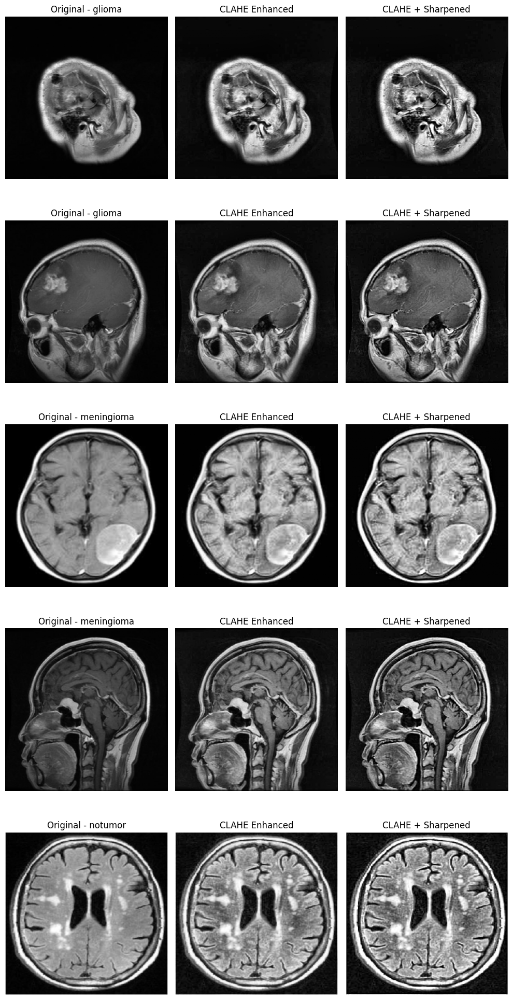

In [7]:
def show_original_vs_enhanced(directory, total_images=5, image_size=(224, 224)):
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    samples = []

    for label in os.listdir(directory):
        class_dir = os.path.join(directory, label)
        if not os.path.isdir(class_dir):
            continue

        # Get sample images
        files = [f for f in os.listdir(class_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
        selected = random.sample(files, min(2, len(files)))
        for file in selected:
            samples.append((os.path.join(class_dir, file), label))
            if len(samples) >= total_images:
                break
        if len(samples) >= total_images:
            break

    # Display
    plt.figure(figsize=(10, 4 * len(samples)))
    for i, (img_path, label) in enumerate(samples):
        try:
            img = cv2.imread(img_path)
            gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            gray_resized = cv2.resize(gray, image_size)

            # CLAHE
            clahe_applied = clahe.apply(gray_resized)

            # Sharpening
            blurred = cv2.GaussianBlur(clahe_applied, (0, 0), sigmaX=1.5)
            sharpened = cv2.addWeighted(clahe_applied, 1.5, blurred, -0.5, 0)

            # Original
            plt.subplot(len(samples), 3, 3 * i + 1)
            plt.imshow(gray_resized, cmap='gray')
            plt.title(f"Original - {label}")
            plt.axis('off')

            # CLAHE only
            plt.subplot(len(samples), 3, 3 * i + 2)
            plt.imshow(clahe_applied, cmap='gray')
            plt.title("CLAHE Enhanced")
            plt.axis('off')

            # CLAHE + Sharpened
            plt.subplot(len(samples), 3, 3 * i + 3)
            plt.imshow(sharpened, cmap='gray')
            plt.title("CLAHE + Sharpened")
            plt.axis('off')

        except Exception as e:
            print(f"Error displaying {img_path}: {e}")

    plt.tight_layout()
    plt.show()

show_original_vs_enhanced(train_dir, total_images=5)

**ImageDataGenerator.flow() for augmentation**

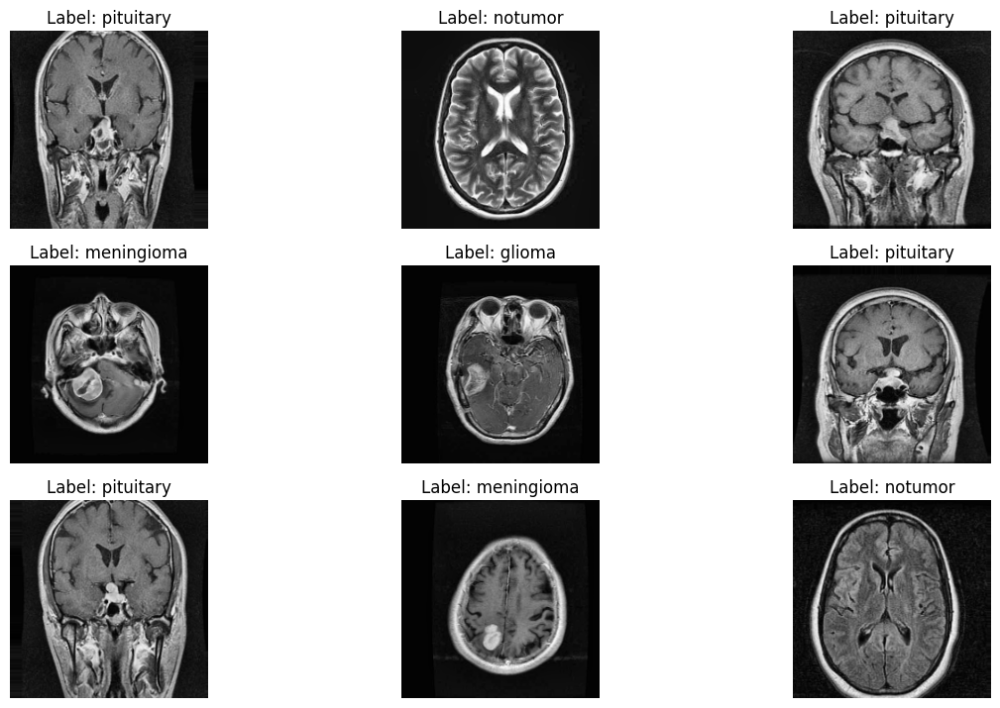

In [8]:
batch_size = 32

train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=0,
    zoom_range=0.1,
    width_shift_range=0.05,
    height_shift_range=0.05,
    shear_range=0.05,
    horizontal_flip=True,
    fill_mode='nearest'
)

train_generator = train_datagen.flow(X_train, y_train, batch_size=batch_size, shuffle=True)

val_test_datagen = ImageDataGenerator(rescale=1./255)  # No augmentation

val_generator = val_test_datagen.flow(X_val, y_val, batch_size=batch_size, shuffle=False)
test_generator = val_test_datagen.flow(X_test, y_test, batch_size=batch_size, shuffle=False)

# Get a batch of augmented images and labels
augmented_images, augmented_labels = next(train_generator)
# Reverse one-hot encoding to get class indices
label_indices = np.argmax(augmented_labels, axis=1)
class_names = label_encoder.classes_
plt.figure(figsize=(12, 12))
for i in range(9):
    plt.subplot(5, 3, i + 1)
    img = np.clip(augmented_images[i], 0, 1)
    plt.imshow(img)
    plt.title(f"Label: {class_names[label_indices[i]]}")
    plt.axis('off')
plt.tight_layout()
plt.show()

**Plotting Class Distribution of Dataset**

In [9]:
def plot_dataset_distribution(train_dir, test_dir, y_val, label_encoder, save_path=None):
    def check_class_distribution(directory):
        class_counts = {}
        for class_name in os.listdir(directory):
            class_dir = os.path.join(directory, class_name)
            if os.path.isdir(class_dir):
                num_images = len([
                    file for file in os.listdir(class_dir)
                    if file.lower().endswith(('.png', '.jpg', '.jpeg'))
                ])
                class_counts[class_name] = num_images
        return class_counts

    # Compute counts
    train_counts = check_class_distribution(train_dir)
    test_counts = check_class_distribution(test_dir)

    val_indices = np.argmax(y_val, axis=1)
    val_class_names = label_encoder.classes_
    val_labels = [val_class_names[i] for i in val_indices]
    val_counts = dict(Counter(val_labels))

    all_classes = sorted(set(list(train_counts) + list(val_counts) + list(test_counts)))

    train = [train_counts.get(cls, 0) for cls in all_classes]
    val = [val_counts.get(cls, 0) for cls in all_classes]
    test = [test_counts.get(cls, 0) for cls in all_classes]

    # Plot
    x = np.arange(len(all_classes))
    width = 0.25

    plt.figure(figsize=(12, 7))
    bars1 = plt.bar(x - width, train, width, label='Training Set', color='#1f77b4')
    bars2 = plt.bar(x, val, width, label='Validation Set', color='#ff7f0e')
    bars3 = plt.bar(x + width, test, width, label='Testing Set', color='#2ca02c')

    # Add counts on top of bars
    for bars in [bars1, bars2, bars3]:
        for bar in bars:
            yval = bar.get_height()
            plt.text(bar.get_x() + bar.get_width()/2, yval + 5, int(yval), ha='center', va='bottom', fontsize=8)

    plt.ylabel('Number of Images')
    plt.xlabel('Class Labels')
    plt.title('Images per Class Label in the Dataset Split')
    plt.xticks(x, all_classes)
    plt.legend()
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path)
        print(f"Bar chart saved to {save_path}")
    else:
        plt.show()


**Checking If there is imbalance in the classes**

In [10]:

def check_class_distribution(directory):
    class_counts = {}
    for class_name in os.listdir(directory):
        class_dir = os.path.join(directory, class_name)
        if os.path.isdir(class_dir):
            num_images = len([file for file in os.listdir(class_dir) if file.lower().endswith(('.png', '.jpg', '.jpeg'))])
            class_counts[class_name] = num_images
    return class_counts

train_class_distribution = check_class_distribution(train_dir)
print("Training class distribution:", train_class_distribution)
test_class_distribution = check_class_distribution(test_dir)
print("Testing class distribution:", test_class_distribution)

Training class distribution: {'glioma': 2147, 'meningioma': 2161, 'notumor': 1990, 'pituitary': 2284}
Testing class distribution: {'glioma': 400, 'meningioma': 421, 'notumor': 510, 'pituitary': 374}


**Compute class imbalance ratio**

In [11]:
def compute_imbalance_ratio(class_counts):
    max_class = max(class_counts.values())
    ratios = {cls: round(count / max_class, 2) for cls, count in class_counts.items()}
    print("Imbalance Ratios (relative to max class):", ratios)


train_class_distribution = check_class_distribution(train_dir)
compute_imbalance_ratio(train_class_distribution)

Imbalance Ratios (relative to max class): {'glioma': 0.94, 'meningioma': 0.95, 'notumor': 0.87, 'pituitary': 1.0}


**Overall Class Distribution With Bar Chart**

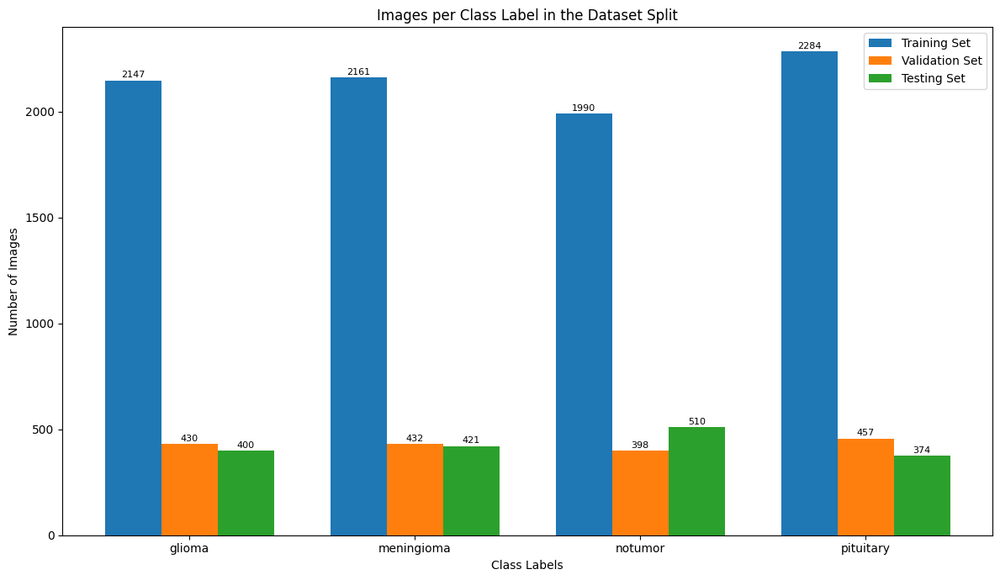

In [12]:
plot_dataset_distribution(train_dir, test_dir, y_val, label_encoder)

**Build the Model**

In [13]:
# Model parameters
input_shape = (224, 224, 3)
num_classes = y_train.shape[1]

# Load ResNet50 base
base_model = ResNet50(include_top=False, weights='imagenet', input_shape=input_shape)
base_model.trainable = False  # freeze base layers

# Build top model
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = BatchNormalization()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.4)(x)
x = Dense(128, activation='relu')(x)
x = Dropout(0.4)(x)
x = BatchNormalization()(x)
predictions = Dense(num_classes, activation='softmax')(x)

# Final model
model = Model(inputs=base_model.input, outputs=predictions)

# Compile
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss='categorical_crossentropy',
              metrics=['accuracy'])
model.summary()
#for grad-cam heatmap i used this layer conv5_block3_out    just the layer before classification


94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 230, 230,  │          0 │ input_layer[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 56, 56,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 56, 56,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 56, 56,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 56, 56,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 56, 56,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_3_c

 Total params: 24,711,684 (94.27 MB)

 Trainable params: 1,119,620 (4.27 MB)

 Non-trainable params: 23,592,064 (90.00 MB)

**Custom callback for logging confusion matrix**

In [14]:
%load_ext tensorboard


# Utility to convert Matplotlib figure to TF image
def plot_to_image(figure):
    buf = io.BytesIO()
    figure.savefig(buf, format='png')
    plt.close(figure)
    buf.seek(0)
    image = tf.image.decode_png(buf.getvalue(), channels=4)
    return tf.expand_dims(image, 0)

# Utility to plot confusion matrix
def plot_confusion_matrix(cm, class_names):
    figure = plt.figure(figsize=(8, 8))
    plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
    plt.title("Confusion Matrix")
    plt.colorbar()

    tick_marks = np.arange(len(class_names))
    plt.xticks(tick_marks, class_names, rotation=45, ha="right")
    plt.yticks(tick_marks, class_names)

    # Print numbers inside the matrix
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, f"{cm[i, j]}",
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel("True label")
    plt.xlabel("Predicted label")
    plt.tight_layout()
    return figure

# Callback class to log confusion matrix to TensorBoard
class ConfusionMatrixCallback(Callback):
    def __init__(self, val_generator, log_dir, class_names):
        super().__init__()
        self.val_generator = val_generator
        self.class_names = class_names
        self.file_writer_cm = tf.summary.create_file_writer(log_dir)

    def on_epoch_end(self, epoch, logs=None):
        try:
            # Predict once per epoch with no output
            y_pred_probs = self.model.predict(self.val_generator, verbose=0)
            y_pred = np.argmax(y_pred_probs, axis=1)
            y_true = np.argmax(np.vstack([y for _, y in self.val_generator]), axis=1)

            cm = confusion_matrix(y_true, y_pred)
            figure = plot_confusion_matrix(cm, class_names=self.class_names)
            cm_image = plot_to_image(figure)

            with self.file_writer_cm.as_default():
                tf.summary.image("Confusion Matrix", cm_image, step=epoch)
                self.file_writer_cm.flush()
        except Exception as e:
            print(f"ConfusionMatrixCallback failed on epoch {epoch + 1}: {e}")

from sklearn.metrics import precision_score, recall_score, f1_score

class MetricsLoggerCallback(Callback):
    def __init__(self, val_generator, log_dir):
        super().__init__()
        self.val_generator = val_generator
        self.file_writer = tf.summary.create_file_writer(log_dir)

    def on_epoch_end(self, epoch, logs=None):
        try:
            # Predict silently
            y_pred_probs = self.model.predict(self.val_generator, verbose=0)
            y_pred = np.argmax(y_pred_probs, axis=1)

            # Decode ground truth
            y_true = np.argmax(np.vstack([y for _, y in self.val_generator]), axis=1)

            # Compute metrics
            precision = precision_score(y_true, y_pred, average='macro')
            recall = recall_score(y_true, y_pred, average='macro')
            f1 = f1_score(y_true, y_pred, average='macro')

            # Log metrics to TensorBoard
            with self.file_writer.as_default():
                tf.summary.scalar("Precision", precision, step=epoch)
                tf.summary.scalar("Recall", recall, step=epoch)
                tf.summary.scalar("F1 Score", f1, step=epoch)
                self.file_writer.flush()

            print(f"[Epoch {epoch+1}] Precision: {precision:.4f}, Recall: {recall:.4f}, F1 Score: {f1:.4f}")
        except Exception as e:
            print(f"MetricsLoggerCallback failed on epoch {epoch+1}: {e}")



%tensorboard --logdir new_logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1908), started 1:46:39 ago. (Use '!kill 1908' to kill it.)

<IPython.core.display.Javascript object>

**Calculating Class Weightes to reduce bias toward notumor class**

In [15]:
# Get numeric labels for computing weights
y_train_labels = np.argmax(y_train, axis=1)

# Compute class weights
class_weights_array = compute_class_weight(class_weight='balanced',
                                           classes=np.unique(y_train_labels),
                                           y=y_train_labels)
class_weights = dict(enumerate(class_weights_array))
print("Class weights:", class_weights)


Class weights: {0: np.float64(0.999563191613279), 1: np.float64(0.9926257952573742), 2: np.float64(1.0780464824120604), 3: np.float64(0.9393814997263273)}


In [ ]:
class_names = list(label_encoder.classes_)
log_root = "new_logs"
log_dir = os.path.join(log_root, datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
file_writer_cm = tf.summary.create_file_writer(log_dir)

tensorboard = TensorBoard(
    log_dir=log_dir,
    histogram_freq=1,
    write_graph=True,
    write_images=True,
    update_freq='epoch',
    profile_batch=0
)

checkpoint_h5 = ModelCheckpoint(
    filepath='before_model_fine_tuned.h5',
    monitor='val_loss', verbose=1, save_best_only=True, mode='min'
)
checkpoint_keras = ModelCheckpoint(
    filepath='before_model_fine_tuned.keras',
    monitor='val_loss', verbose=1, save_best_only=True, mode='min'
)
ES = EarlyStopping(monitor='val_loss', min_delta=0.001, patience=5, restore_best_weights=True, verbose=1, mode='min')
RL = ReduceLROnPlateau(monitor='val_loss', factor=0.3, patience=5, verbose=1, mode='min')
callbacks = [checkpoint_h5,checkpoint_keras, tensorboard, ES, RL]
# Train
history = model.fit(
    train_generator,
    validation_data=val_generator,
    epochs=30,
    steps_per_epoch=len(train_generator),
    validation_steps=len(val_generator),
    class_weight=class_weights,
    callbacks=callbacks,
    verbose=1
)

with open("history_base.pkl", "wb") as f:
    pickle.dump(history.history, f)


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step - accuracy: 0.4572 - loss: 1.3781
Epoch 1: val_loss improved from inf to 1.04639, saving model to before_model_fine_tuned.h5



Epoch 1: val_loss improved from inf to 1.04639, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 103s 416ms/step - accuracy: 0.4576 - loss: 1.3771 - val_accuracy: 0.5655 - val_loss: 1.0464 - learning_rate: 1.0000e-04
Epoch 2/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step - accuracy: 0.6284 - loss: 0.9335
Epoch 2: val_loss improved from 1.04639 to 0.82781, saving model to before_model_fine_tuned.h5



Epoch 2: val_loss improved from 1.04639 to 0.82781, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 77s 360ms/step - accuracy: 0.6285 - loss: 0.9334 - val_accuracy: 0.6797 - val_loss: 0.8278 - learning_rate: 1.0000e-04
Epoch 3/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - accuracy: 0.6693 - loss: 0.8230
Epoch 3: val_loss improved from 0.82781 to 0.65022, saving model to before_model_fine_tuned.h5



Epoch 3: val_loss improved from 0.82781 to 0.65022, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 77s 356ms/step - accuracy: 0.6694 - loss: 0.8230 - val_accuracy: 0.7467 - val_loss: 0.6502 - learning_rate: 1.0000e-04
Epoch 4/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step - accuracy: 0.6973 - loss: 0.7575
Epoch 4: val_loss improved from 0.65022 to 0.56960, saving model to before_model_fine_tuned.h5



Epoch 4: val_loss improved from 0.65022 to 0.56960, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 77s 358ms/step - accuracy: 0.6974 - loss: 0.7574 - val_accuracy: 0.7822 - val_loss: 0.5696 - learning_rate: 1.0000e-04
Epoch 5/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step - accuracy: 0.7128 - loss: 0.7200
Epoch 5: val_loss did not improve from 0.56960

Epoch 5: val_loss did not improve from 0.56960
215/215 ━━━━━━━━━━━━━━━━━━━━ 75s 347ms/step - accuracy: 0.7128 - loss: 0.7200 - val_accuracy: 0.7822 - val_loss: 0.5712 - learning_rate: 1.0000e-04
Epoch 6/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - accuracy: 0.7221 - loss: 0.6936
Epoch 6: val_loss improved from 0.56960 to 0.50910, saving model to before_model_fine_tuned.h5



Epoch 6: val_loss improved from 0.56960 to 0.50910, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 77s 357ms/step - accuracy: 0.7221 - loss: 0.6935 - val_accuracy: 0.7950 - val_loss: 0.5091 - learning_rate: 1.0000e-04
Epoch 7/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - accuracy: 0.7225 - loss: 0.6633
Epoch 7: val_loss improved from 0.50910 to 0.49495, saving model to before_model_fine_tuned.h5



Epoch 7: val_loss improved from 0.50910 to 0.49495, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 77s 359ms/step - accuracy: 0.7226 - loss: 0.6632 - val_accuracy: 0.8002 - val_loss: 0.4950 - learning_rate: 1.0000e-04
Epoch 8/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - accuracy: 0.7455 - loss: 0.6127
Epoch 8: val_loss improved from 0.49495 to 0.46415, saving model to before_model_fine_tuned.h5



Epoch 8: val_loss improved from 0.49495 to 0.46415, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 77s 357ms/step - accuracy: 0.7455 - loss: 0.6127 - val_accuracy: 0.8142 - val_loss: 0.4641 - learning_rate: 1.0000e-04
Epoch 9/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - accuracy: 0.7457 - loss: 0.6208
Epoch 9: val_loss did not improve from 0.46415

Epoch 9: val_loss did not improve from 0.46415
215/215 ━━━━━━━━━━━━━━━━━━━━ 74s 346ms/step - accuracy: 0.7457 - loss: 0.6207 - val_accuracy: 0.8037 - val_loss: 0.4663 - learning_rate: 1.0000e-04
Epoch 10/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step - accuracy: 0.7620 - loss: 0.5865
Epoch 10: val_loss improved from 0.46415 to 0.44981, saving model to before_model_fine_tuned.h5



Epoch 10: val_loss improved from 0.46415 to 0.44981, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 77s 356ms/step - accuracy: 0.7620 - loss: 0.5865 - val_accuracy: 0.8200 - val_loss: 0.4498 - learning_rate: 1.0000e-04
Epoch 11/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - accuracy: 0.7622 - loss: 0.5805
Epoch 11: val_loss did not improve from 0.44981

Epoch 11: val_loss did not improve from 0.44981
215/215 ━━━━━━━━━━━━━━━━━━━━ 74s 345ms/step - accuracy: 0.7622 - loss: 0.5805 - val_accuracy: 0.8212 - val_loss: 0.4509 - learning_rate: 1.0000e-04
Epoch 12/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step - accuracy: 0.7755 - loss: 0.5460
Epoch 12: val_loss improved from 0.44981 to 0.44137, saving model to before_model_fine_tuned.h5



Epoch 12: val_loss improved from 0.44981 to 0.44137, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 76s 356ms/step - accuracy: 0.7755 - loss: 0.5461 - val_accuracy: 0.8241 - val_loss: 0.4414 - learning_rate: 1.0000e-04
Epoch 13/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - accuracy: 0.7807 - loss: 0.5482
Epoch 13: val_loss improved from 0.44137 to 0.42819, saving model to before_model_fine_tuned.h5



Epoch 13: val_loss improved from 0.44137 to 0.42819, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 77s 357ms/step - accuracy: 0.7807 - loss: 0.5482 - val_accuracy: 0.8352 - val_loss: 0.4282 - learning_rate: 1.0000e-04
Epoch 14/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - accuracy: 0.7885 - loss: 0.5450
Epoch 14: val_loss improved from 0.42819 to 0.41739, saving model to before_model_fine_tuned.h5



Epoch 14: val_loss improved from 0.42819 to 0.41739, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 77s 356ms/step - accuracy: 0.7885 - loss: 0.5450 - val_accuracy: 0.8363 - val_loss: 0.4174 - learning_rate: 1.0000e-04
Epoch 15/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - accuracy: 0.7836 - loss: 0.5420
Epoch 15: val_loss improved from 0.41739 to 0.41012, saving model to before_model_fine_tuned.h5



Epoch 15: val_loss improved from 0.41739 to 0.41012, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 77s 359ms/step - accuracy: 0.7836 - loss: 0.5420 - val_accuracy: 0.8328 - val_loss: 0.4101 - learning_rate: 1.0000e-04
Epoch 16/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step - accuracy: 0.7914 - loss: 0.5092
Epoch 16: val_loss did not improve from 0.41012

Epoch 16: val_loss did not improve from 0.41012
215/215 ━━━━━━━━━━━━━━━━━━━━ 74s 344ms/step - accuracy: 0.7914 - loss: 0.5092 - val_accuracy: 0.8393 - val_loss: 0.4106 - learning_rate: 1.0000e-04
Epoch 17/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step - accuracy: 0.7973 - loss: 0.5034
Epoch 17: val_loss improved from 0.41012 to 0.39960, saving model to before_model_fine_tuned.h5



Epoch 17: val_loss improved from 0.41012 to 0.39960, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 77s 359ms/step - accuracy: 0.7973 - loss: 0.5034 - val_accuracy: 0.8334 - val_loss: 0.3996 - learning_rate: 1.0000e-04
Epoch 18/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - accuracy: 0.7891 - loss: 0.5190
Epoch 18: val_loss improved from 0.39960 to 0.38699, saving model to before_model_fine_tuned.h5



Epoch 18: val_loss improved from 0.39960 to 0.38699, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 77s 357ms/step - accuracy: 0.7892 - loss: 0.5189 - val_accuracy: 0.8398 - val_loss: 0.3870 - learning_rate: 1.0000e-04
Epoch 19/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step - accuracy: 0.8033 - loss: 0.4831
Epoch 19: val_loss did not improve from 0.38699

Epoch 19: val_loss did not improve from 0.38699
215/215 ━━━━━━━━━━━━━━━━━━━━ 74s 346ms/step - accuracy: 0.8033 - loss: 0.4831 - val_accuracy: 0.8445 - val_loss: 0.3914 - learning_rate: 1.0000e-04
Epoch 20/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step - accuracy: 0.8113 - loss: 0.4675
Epoch 20: val_loss improved from 0.38699 to 0.38071, saving model to before_model_fine_tuned.h5



Epoch 20: val_loss improved from 0.38699 to 0.38071, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 77s 359ms/step - accuracy: 0.8113 - loss: 0.4676 - val_accuracy: 0.8474 - val_loss: 0.3807 - learning_rate: 1.0000e-04
Epoch 21/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step - accuracy: 0.8165 - loss: 0.4547
Epoch 21: val_loss improved from 0.38071 to 0.37317, saving model to before_model_fine_tuned.h5



Epoch 21: val_loss improved from 0.38071 to 0.37317, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 77s 359ms/step - accuracy: 0.8164 - loss: 0.4548 - val_accuracy: 0.8532 - val_loss: 0.3732 - learning_rate: 1.0000e-04
Epoch 22/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - accuracy: 0.8155 - loss: 0.4572
Epoch 22: val_loss improved from 0.37317 to 0.35937, saving model to before_model_fine_tuned.h5



Epoch 22: val_loss improved from 0.37317 to 0.35937, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 77s 358ms/step - accuracy: 0.8155 - loss: 0.4572 - val_accuracy: 0.8526 - val_loss: 0.3594 - learning_rate: 1.0000e-04
Epoch 23/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step - accuracy: 0.8023 - loss: 0.4940
Epoch 23: val_loss improved from 0.35937 to 0.35250, saving model to before_model_fine_tuned.h5



Epoch 23: val_loss improved from 0.35937 to 0.35250, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 76s 354ms/step - accuracy: 0.8024 - loss: 0.4939 - val_accuracy: 0.8538 - val_loss: 0.3525 - learning_rate: 1.0000e-04
Epoch 24/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step - accuracy: 0.8167 - loss: 0.4642
Epoch 24: val_loss did not improve from 0.35250

Epoch 24: val_loss did not improve from 0.35250
215/215 ━━━━━━━━━━━━━━━━━━━━ 74s 343ms/step - accuracy: 0.8167 - loss: 0.4641 - val_accuracy: 0.8550 - val_loss: 0.3616 - learning_rate: 1.0000e-04
Epoch 25/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step - accuracy: 0.8144 - loss: 0.4470
Epoch 25: val_loss improved from 0.35250 to 0.33750, saving model to before_model_fine_tuned.h5



Epoch 25: val_loss improved from 0.35250 to 0.33750, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 76s 355ms/step - accuracy: 0.8144 - loss: 0.4470 - val_accuracy: 0.8643 - val_loss: 0.3375 - learning_rate: 1.0000e-04
Epoch 26/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step - accuracy: 0.8308 - loss: 0.4293
Epoch 26: val_loss did not improve from 0.33750

Epoch 26: val_loss did not improve from 0.33750
215/215 ━━━━━━━━━━━━━━━━━━━━ 74s 345ms/step - accuracy: 0.8307 - loss: 0.4294 - val_accuracy: 0.8556 - val_loss: 0.3495 - learning_rate: 1.0000e-04
Epoch 27/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step - accuracy: 0.8194 - loss: 0.4591
Epoch 27: val_loss improved from 0.33750 to 0.32357, saving model to before_model_fine_tuned.h5



Epoch 27: val_loss improved from 0.33750 to 0.32357, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 76s 353ms/step - accuracy: 0.8195 - loss: 0.4591 - val_accuracy: 0.8591 - val_loss: 0.3236 - learning_rate: 1.0000e-04
Epoch 28/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step - accuracy: 0.8257 - loss: 0.4271
Epoch 28: val_loss did not improve from 0.32357

Epoch 28: val_loss did not improve from 0.32357
215/215 ━━━━━━━━━━━━━━━━━━━━ 74s 346ms/step - accuracy: 0.8257 - loss: 0.4271 - val_accuracy: 0.8567 - val_loss: 0.3487 - learning_rate: 1.0000e-04
Epoch 29/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step - accuracy: 0.8201 - loss: 0.4297
Epoch 29: val_loss did not improve from 0.32357

Epoch 29: val_loss did not improve from 0.32357
215/215 ━━━━━━━━━━━━━━━━━━━━ 74s 343ms/step - accuracy: 0.8201 - loss: 0.4297 - val_accuracy: 0.8684 - val_loss: 0.3272 - learning_rate: 1.0000e-04
Epoch 30/30
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step - accuracy: 0.8248 - loss: 0.


Epoch 30: val_loss improved from 0.32357 to 0.31259, saving model to before_model_fine_tuned.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 76s 353ms/step - accuracy: 0.8248 - loss: 0.4155 - val_accuracy: 0.8678 - val_loss: 0.3126 - learning_rate: 1.0000e-04
Restoring model weights from the end of the best epoch: 30.


**Fine-Tune the Model**

In [ ]:
base_model.trainable = True

model.compile(optimizer=Adam(learning_rate=1e-5), #This is fine-tuned model. the frozen layer in previous base model unfrozen here.
              loss='categorical_crossentropy',
              metrics=['accuracy'])
model.summary()

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 230, 230,  │          0 │ input_layer_4[0]… │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 56, 56,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 56, 56,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 56, 56,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 56, 56,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 56, 56,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_3_c

 Total params: 24,711,684 (94.27 MB)

 Trainable params: 24,654,212 (94.05 MB)

 Non-trainable params: 57,472 (224.50 KB)

In [ ]:
steps_per_epoch=len(train_generator),
validation_steps=len(val_generator),
print('train-s: ', steps_per_epoch)
print('validation-s: ', validation_steps)

train-s:  (215,)
validation-s:  (54,)


In [ ]:
fine_tuned_class_names = list(label_encoder.classes_)
fine_tuned_log_root = "fine_tuned_logs"
fine_tuned_log_dir = os.path.join(fine_tuned_log_root, datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
fine_tuned_file_writer_cm = tf.summary.create_file_writer(fine_tuned_log_dir)
fine_tuned_tensorboard = TensorBoard(
    log_dir=fine_tuned_log_dir,
    histogram_freq=1,
    write_graph=True,
    write_images=True,
    update_freq='epoch',
    profile_batch=0
)

fine_tuned_checkpoint_h5 = ModelCheckpoint(
    filepath='fine_tuned_model.h5',
    monitor='val_loss', verbose=1, save_best_only=True, mode='min'
)
fine_tuned_checkpoint_keras = ModelCheckpoint(
    filepath='fine_tuned_model.keras',
    monitor='val_loss', verbose=1, save_best_only=True, mode='min'
)

Fine_Tuned_ES = EarlyStopping(monitor='val_loss', min_delta=0.001, patience=5, restore_best_weights=True, verbose=1, mode='min') # I used this to manage convergence
Fine_Tuned_RL = ReduceLROnPlateau(monitor='val_loss', factor=0.3, patience=5, verbose=1, mode='min') # I aslo used this to manage convergence as well
fine_tuned_callbacks = [fine_tuned_checkpoint_h5, fine_tuned_checkpoint_keras, fine_tuned_tensorboard, Fine_Tuned_ES, Fine_Tuned_RL]
history_fine_tuned = model.fit(
    train_generator,
    validation_data=val_generator,
    epochs=20,
    steps_per_epoch=len(train_generator),
    validation_steps=len(val_generator),
    class_weight=class_weights,
    callbacks=fine_tuned_callbacks
)
with open("history_ft.pkl", "wb") as f:
    pickle.dump(history_fine_tuned.history, f)

Epoch 1/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step - accuracy: 0.5901 - loss: 1.1868
Epoch 1: val_loss improved from inf to 2.15915, saving model to fine_tuned_model.h5



Epoch 1: val_loss improved from inf to 2.15915, saving model to fine_tuned_model.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 157s 476ms/step - accuracy: 0.5907 - loss: 1.1848 - val_accuracy: 0.3098 - val_loss: 2.1591 - learning_rate: 1.0000e-05
Epoch 2/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step - accuracy: 0.8685 - loss: 0.3669
Epoch 2: val_loss did not improve from 2.15915

Epoch 2: val_loss did not improve from 2.15915
215/215 ━━━━━━━━━━━━━━━━━━━━ 74s 343ms/step - accuracy: 0.8685 - loss: 0.3669 - val_accuracy: 0.3739 - val_loss: 2.7141 - learning_rate: 1.0000e-05
Epoch 3/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step - accuracy: 0.8921 - loss: 0.2922
Epoch 3: val_loss did not improve from 2.15915

Epoch 3: val_loss did not improve from 2.15915
215/215 ━━━━━━━━━━━━━━━━━━━━ 73s 340ms/step - accuracy: 0.8922 - loss: 0.2921 - val_accuracy: 0.5015 - val_loss: 2.4356 - learning_rate: 1.0000e-05
Epoch 4/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step - accuracy: 0.9214 - loss: 0.2272
Epoch 4: val_


Epoch 4: val_loss improved from 2.15915 to 1.65982, saving model to fine_tuned_model.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 80s 370ms/step - accuracy: 0.9214 - loss: 0.2271 - val_accuracy: 0.5510 - val_loss: 1.6598 - learning_rate: 1.0000e-05
Epoch 5/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - accuracy: 0.9355 - loss: 0.1815
Epoch 5: val_loss improved from 1.65982 to 0.67026, saving model to fine_tuned_model.h5



Epoch 5: val_loss improved from 1.65982 to 0.67026, saving model to fine_tuned_model.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 80s 372ms/step - accuracy: 0.9355 - loss: 0.1815 - val_accuracy: 0.7193 - val_loss: 0.6703 - learning_rate: 1.0000e-05
Epoch 6/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step - accuracy: 0.9486 - loss: 0.1545
Epoch 6: val_loss improved from 0.67026 to 0.61189, saving model to fine_tuned_model.h5



Epoch 6: val_loss improved from 0.67026 to 0.61189, saving model to fine_tuned_model.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 80s 370ms/step - accuracy: 0.9486 - loss: 0.1545 - val_accuracy: 0.7531 - val_loss: 0.6119 - learning_rate: 1.0000e-05
Epoch 7/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step - accuracy: 0.9618 - loss: 0.1271
Epoch 7: val_loss improved from 0.61189 to 0.42389, saving model to fine_tuned_model.h5



Epoch 7: val_loss improved from 0.61189 to 0.42389, saving model to fine_tuned_model.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 79s 368ms/step - accuracy: 0.9618 - loss: 0.1271 - val_accuracy: 0.8381 - val_loss: 0.4239 - learning_rate: 1.0000e-05
Epoch 8/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - accuracy: 0.9627 - loss: 0.1108
Epoch 8: val_loss improved from 0.42389 to 0.10968, saving model to fine_tuned_model.h5



Epoch 8: val_loss improved from 0.42389 to 0.10968, saving model to fine_tuned_model.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 80s 371ms/step - accuracy: 0.9627 - loss: 0.1108 - val_accuracy: 0.9598 - val_loss: 0.1097 - learning_rate: 1.0000e-05
Epoch 9/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step - accuracy: 0.9753 - loss: 0.0823
Epoch 9: val_loss did not improve from 0.10968

Epoch 9: val_loss did not improve from 0.10968
215/215 ━━━━━━━━━━━━━━━━━━━━ 74s 344ms/step - accuracy: 0.9753 - loss: 0.0823 - val_accuracy: 0.9394 - val_loss: 0.1524 - learning_rate: 1.0000e-05
Epoch 10/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step - accuracy: 0.9796 - loss: 0.0751
Epoch 10: val_loss did not improve from 0.10968

Epoch 10: val_loss did not improve from 0.10968
215/215 ━━━━━━━━━━━━━━━━━━━━ 74s 344ms/step - accuracy: 0.9796 - loss: 0.0751 - val_accuracy: 0.9616 - val_loss: 0.1161 - learning_rate: 1.0000e-05
Epoch 11/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step - accuracy: 0.9844 - loss: 0.0648
Epoch 


Epoch 11: val_loss improved from 0.10968 to 0.07886, saving model to fine_tuned_model.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 79s 368ms/step - accuracy: 0.9844 - loss: 0.0648 - val_accuracy: 0.9697 - val_loss: 0.0789 - learning_rate: 1.0000e-05
Epoch 12/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step - accuracy: 0.9821 - loss: 0.0581
Epoch 12: val_loss did not improve from 0.07886

Epoch 12: val_loss did not improve from 0.07886
215/215 ━━━━━━━━━━━━━━━━━━━━ 76s 352ms/step - accuracy: 0.9821 - loss: 0.0581 - val_accuracy: 0.9732 - val_loss: 0.0793 - learning_rate: 1.0000e-05
Epoch 13/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step - accuracy: 0.9866 - loss: 0.0517
Epoch 13: val_loss did not improve from 0.07886

Epoch 13: val_loss did not improve from 0.07886
215/215 ━━━━━━━━━━━━━━━━━━━━ 74s 344ms/step - accuracy: 0.9866 - loss: 0.0517 - val_accuracy: 0.9656 - val_loss: 0.1036 - learning_rate: 1.0000e-05
Epoch 14/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step - accuracy: 0.9884 - loss: 0.0474
Ep


Epoch 14: val_loss improved from 0.07886 to 0.06525, saving model to fine_tuned_model.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 85s 393ms/step - accuracy: 0.9884 - loss: 0.0474 - val_accuracy: 0.9773 - val_loss: 0.0652 - learning_rate: 1.0000e-05
Epoch 15/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step - accuracy: 0.9859 - loss: 0.0525
Epoch 15: val_loss improved from 0.06525 to 0.05685, saving model to fine_tuned_model.h5



Epoch 15: val_loss improved from 0.06525 to 0.05685, saving model to fine_tuned_model.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 80s 370ms/step - accuracy: 0.9860 - loss: 0.0525 - val_accuracy: 0.9808 - val_loss: 0.0569 - learning_rate: 1.0000e-05
Epoch 16/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step - accuracy: 0.9917 - loss: 0.0400
Epoch 16: val_loss did not improve from 0.05685

Epoch 16: val_loss did not improve from 0.05685
215/215 ━━━━━━━━━━━━━━━━━━━━ 74s 344ms/step - accuracy: 0.9917 - loss: 0.0400 - val_accuracy: 0.9732 - val_loss: 0.0818 - learning_rate: 1.0000e-05
Epoch 17/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step - accuracy: 0.9923 - loss: 0.0352
Epoch 17: val_loss did not improve from 0.05685

Epoch 17: val_loss did not improve from 0.05685
215/215 ━━━━━━━━━━━━━━━━━━━━ 74s 342ms/step - accuracy: 0.9923 - loss: 0.0352 - val_accuracy: 0.9785 - val_loss: 0.0581 - learning_rate: 1.0000e-05
Epoch 18/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step - accuracy: 0.9894 - loss: 0.0355
Ep


Epoch 18: val_loss improved from 0.05685 to 0.05241, saving model to fine_tuned_model.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 79s 368ms/step - accuracy: 0.9895 - loss: 0.0355 - val_accuracy: 0.9837 - val_loss: 0.0524 - learning_rate: 1.0000e-05
Epoch 19/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step - accuracy: 0.9908 - loss: 0.0359
Epoch 19: val_loss did not improve from 0.05241

Epoch 19: val_loss did not improve from 0.05241
215/215 ━━━━━━━━━━━━━━━━━━━━ 74s 345ms/step - accuracy: 0.9908 - loss: 0.0359 - val_accuracy: 0.9750 - val_loss: 0.0779 - learning_rate: 1.0000e-05
Epoch 20/20
215/215 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step - accuracy: 0.9923 - loss: 0.0304
Epoch 20: val_loss improved from 0.05241 to 0.04710, saving model to fine_tuned_model.h5



Epoch 20: val_loss improved from 0.05241 to 0.04710, saving model to fine_tuned_model.keras
215/215 ━━━━━━━━━━━━━━━━━━━━ 79s 367ms/step - accuracy: 0.9923 - loss: 0.0304 - val_accuracy: 0.9843 - val_loss: 0.0471 - learning_rate: 1.0000e-05
Restoring model weights from the end of the best epoch: 20.


**Lauching Tensor Board After the Model is Fine-Tuned**

In [ ]:
%tensorboard --logdir fine_tuned_logs

<IPython.core.display.Javascript object>

**Model Evaluation Suite**

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Fine-Tuned Model Confusion Matrix:
 [[429   0   0   1]
 [ 13 409   0  10]
 [  0   0 396   2]
 [  0   1   0 456]]
Fine-Tuned Model
Classification Report:
              precision    recall  f1-score   support

      glioma       0.97      1.00      0.98       430
  meningioma       1.00      0.95      0.97       432
     notumor       1.00      0.99      1.00       398
   pituitary       0.97      1.00      0.98       457

    accuracy                           0.98      1717
   macro avg       0.99      0.98      0.98      1717
weighted avg       0.98      0.98      0.98      1717



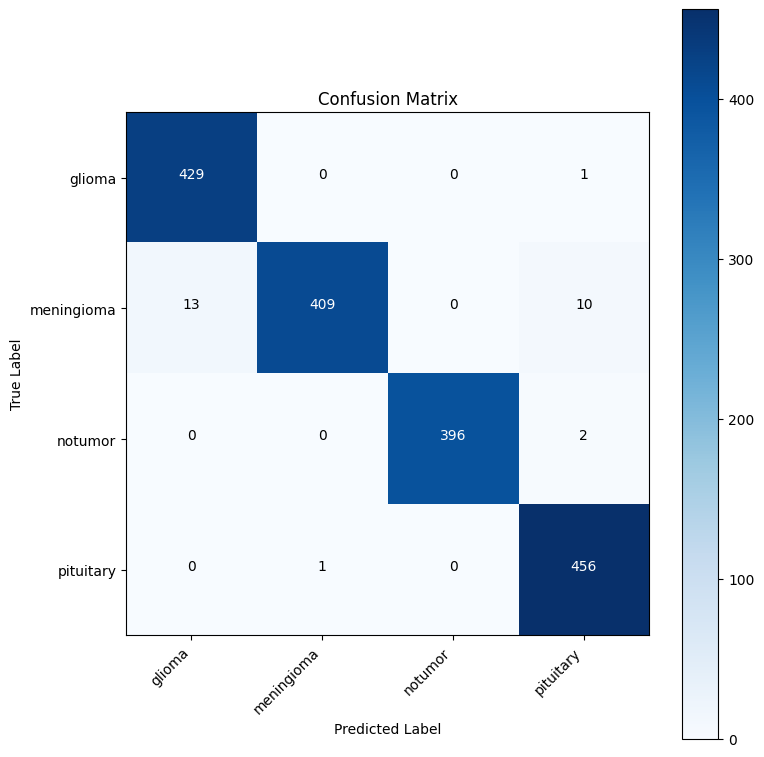


Confusion matrix saved as: fine_tuned_confusion_matrix.png
Logged confusion matrix to TensorBoard at: fine_tuned_logs/eval


Base Model Confusion Matrix:
 [[323  96   3   8]
 [ 30 342  20  40]
 [  0   9 388   1]
 [  3   4   8 442]]
Base Model
Classification Report:
              precision    recall  f1-score   support

      glioma       0.91      0.75      0.82       430
  meningioma       0.76      0.79      0.77       432
     notumor       0.93      0.97      0.95       398
   pituitary       0.90      0.97      0.93       457

    accuracy                           0.87      1717
   macro avg       0.87      0.87      0.87      1717
weighted avg       0.87      0.87      0.87      1717



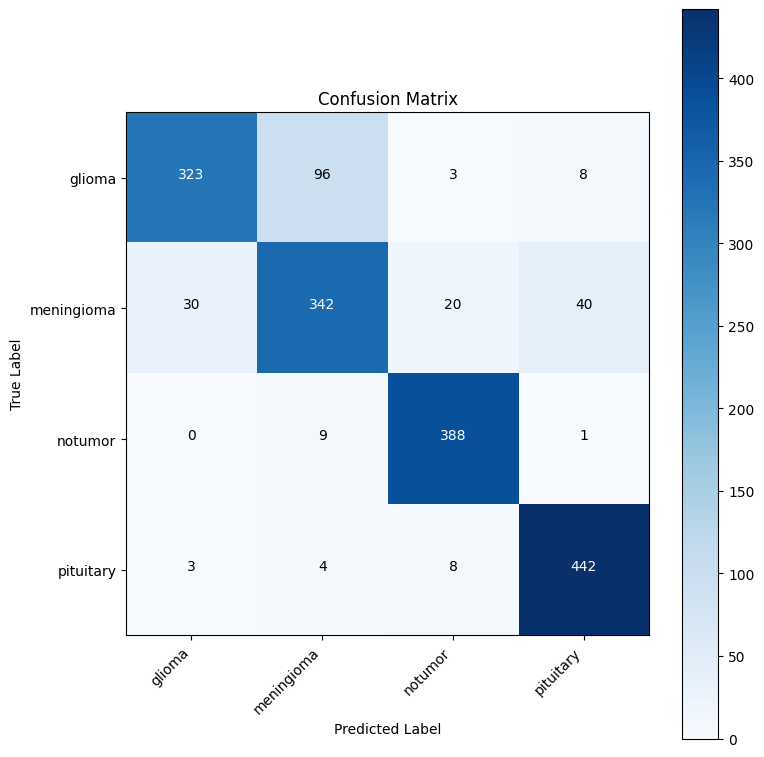


Confusion matrix saved as: base_model_confusion_matrix.png
Logged confusion matrix to TensorBoard at: new_logs/eval


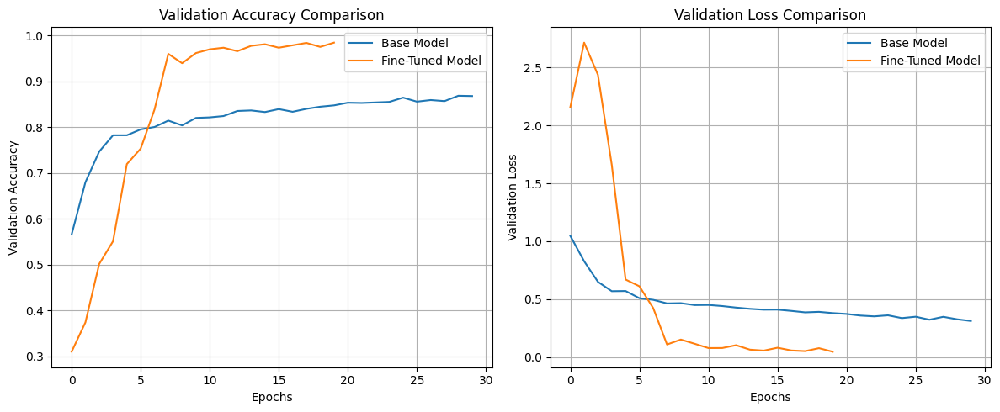

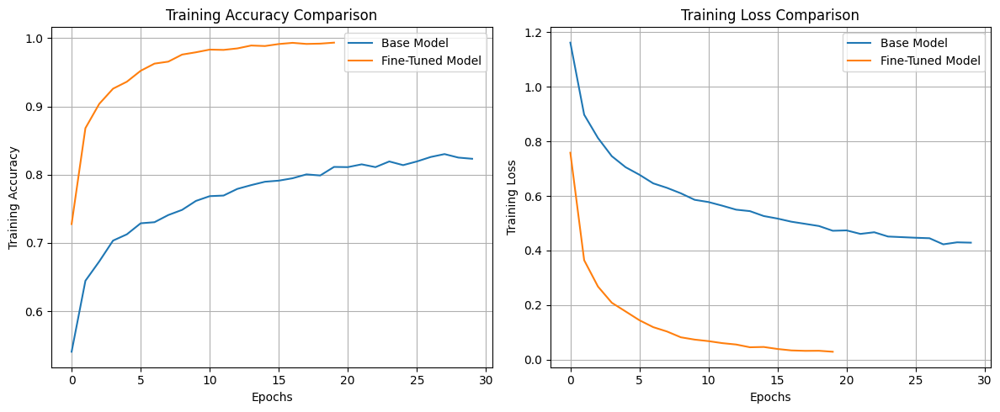


Base Model Metrics:
  ➤ Max Validation Accuracy: 0.8684 at epoch 28
  ➤ Final Validation Accuracy: 0.8678
  ➤ Avg Validation Accuracy: 0.8177
  ➤ Min Validation Loss: 0.3126 at epoch 29
  ➤ Final Validation Loss: 0.3126
  ➤ Avg Validation Loss: 0.4538

Fine-Tuned Model Metrics:
  ➤ Max Validation Accuracy: 0.9843 at epoch 19
  ➤ Final Validation Accuracy: 0.9843
  ➤ Avg Validation Accuracy: 0.8334
  ➤ Min Validation Loss: 0.0471 at epoch 19
  ➤ Final Validation Loss: 0.0471
  ➤ Avg Validation Loss: 0.5877

Base Model (Training) Metrics:
  ➤ Max Validation Accuracy: 0.8302 at epoch 27
  ➤ Final Validation Accuracy: 0.8233
  ➤ Avg Validation Accuracy: 0.7689
  ➤ Min Validation Loss: 0.4227 at epoch 27
  ➤ Final Validation Loss: 0.4288
  ➤ Avg Validation Loss: 0.5731

Fine-Tuned Model (Training) Metrics:
  ➤ Max Validation Accuracy: 0.9934 at epoch 19
  ➤ Final Validation Accuracy: 0.9934
  ➤ Avg Validation Accuracy: 0.9544
  ➤ Min Validation Loss: 0.0290 at epoch 19
  ➤ Final Validation

In [ ]:
def plot_confusion_matrix(cm, class_names):
    figure = plt.figure(figsize=(8, 8))
    plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
    plt.title("Confusion Matrix")
    plt.colorbar()
    tick_marks = np.arange(len(class_names))
    plt.xticks(tick_marks, class_names, rotation=45, ha="right")
    plt.yticks(tick_marks, class_names)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, f"{cm[i, j]}",
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel("True Label")
    plt.xlabel("Predicted Label")
    plt.tight_layout()
    plt.show()
    return figure

def plot_to_image(figure):
    buf = io.BytesIO()
    figure.savefig(buf, format='png')
    plt.close(figure)
    buf.seek(0)
    image = tf.image.decode_png(buf.getvalue(), channels=4)
    return tf.expand_dims(image, 0)

# Evaluation Function
def evaluate_model(model_path, model_status,generator, y_true, class_names, log_dir=None, prefix="eval"):
    model = load_model(model_path)
    y_pred_probs = model.predict(generator, verbose=0)
    y_pred = np.argmax(y_pred_probs, axis=1)

    # Metrics
    cm = confusion_matrix(y_true, y_pred)
    print(f"{model_status} Confusion Matrix:\n", cm)

    print(f"{model_status}\nClassification Report:")
    print(classification_report(y_true, y_pred, target_names=class_names))

    # Save Confusion Matrix PNG
    fig = plot_confusion_matrix(cm, class_names)
    png_name = f"{prefix}_confusion_matrix.png"
    fig.savefig(png_name)
    print(f"\nConfusion matrix saved as: {png_name}")

    # Log to TensorBoard
    if log_dir:
        writer = tf.summary.create_file_writer(log_dir)
        with writer.as_default():
            tf.summary.image(f"{prefix} Confusion Matrix", plot_to_image(fig), step=0)
            writer.flush()
            print(f"Logged confusion matrix to TensorBoard at: {log_dir}")

#Accuracies Comparison

def compare_accuracies(history_base_path, history_ft_path):
    with open(history_base_path, 'rb') as f:
        history_base = pickle.load(f)
    with open(history_ft_path, 'rb') as f:
        history_ft = pickle.load(f)

    # Extract metrics
    metrics = {
        'Base': {
            'val_acc': history_base.get('val_accuracy', []),
            'val_loss': history_base.get('val_loss', []),
            'train_acc': history_base.get('accuracy', []),
            'train_loss': history_base.get('loss', []),
        },
        'Fine-Tuned': {
            'val_acc': history_ft.get('val_accuracy', []),
            'val_loss': history_ft.get('val_loss', []),
            'train_acc': history_ft.get('accuracy', []),
            'train_loss': history_ft.get('loss', []),
        }
    }

    # Plot validation accuracy
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(metrics['Base']['val_acc'], label='Base Model')
    plt.plot(metrics['Fine-Tuned']['val_acc'], label='Fine-Tuned Model')
    plt.xlabel("Epochs")
    plt.ylabel("Validation Accuracy")
    plt.title("Validation Accuracy Comparison")
    plt.legend()
    plt.grid(True)

    # Plot validation loss
    plt.subplot(1, 2, 2)
    plt.plot(metrics['Base']['val_loss'], label='Base Model')
    plt.plot(metrics['Fine-Tuned']['val_loss'], label='Fine-Tuned Model')
    plt.xlabel("Epochs")
    plt.ylabel("Validation Loss")
    plt.title("Validation Loss Comparison")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Plot training accuracy
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(metrics['Base']['train_acc'], label='Base Model')
    plt.plot(metrics['Fine-Tuned']['train_acc'], label='Fine-Tuned Model')
    plt.xlabel("Epochs")
    plt.ylabel("Training Accuracy")
    plt.title("Training Accuracy Comparison")
    plt.legend()
    plt.grid(True)

    # Plot training loss
    plt.subplot(1, 2, 2)
    plt.plot(metrics['Base']['train_loss'], label='Base Model')
    plt.plot(metrics['Fine-Tuned']['train_loss'], label='Fine-Tuned Model')
    plt.xlabel("Epochs")
    plt.ylabel("Training Loss")
    plt.title("Training Loss Comparison")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Summary statistics
    def print_metrics(name, acc, loss):
        print(f"\n{name} Metrics:")
        if acc:
            print(f"  ➤ Max Validation Accuracy: {max(acc):.4f} at epoch {acc.index(max(acc))}")
            print(f"  ➤ Final Validation Accuracy: {acc[-1]:.4f}")
            print(f"  ➤ Avg Validation Accuracy: {sum(acc)/len(acc):.4f}")
        if loss:
            print(f"  ➤ Min Validation Loss: {min(loss):.4f} at epoch {loss.index(min(loss))}")
            print(f"  ➤ Final Validation Loss: {loss[-1]:.4f}")
            print(f"  ➤ Avg Validation Loss: {sum(loss)/len(loss):.4f}")

    print_metrics("Base Model", metrics['Base']['val_acc'], metrics['Base']['val_loss'])
    print_metrics("Fine-Tuned Model", metrics['Fine-Tuned']['val_acc'], metrics['Fine-Tuned']['val_loss'])

    print_metrics("Base Model (Training)", metrics['Base']['train_acc'], metrics['Base']['train_loss'])
    print_metrics("Fine-Tuned Model (Training)", metrics['Fine-Tuned']['train_acc'], metrics['Fine-Tuned']['train_loss'])

# Run All Evaluation Steps
# fine_tuned_model_path = "fine_tuned_model-19-0.98-0.07.h5"
# base_model_path = "before_model_fine_tuned-29-0.83-0.41.h5"
before_model_fine_tuned_path= "before_model_fine_tuned.h5"
after_model_fine_tuned_path="fine_tuned_model.h5"

# Validation labels (only needed once)
y_val_true = np.argmax(y_val, axis=1)

# Evaluate fine-tuned model
evaluate_model(
    model_path=after_model_fine_tuned_path,
    model_status='Fine-Tuned Model',
    generator=val_generator,
    y_true=y_val_true,
    class_names=class_names,
    log_dir="fine_tuned_logs/eval",
    prefix="fine_tuned"
)

# Evaluate base model
evaluate_model(
     model_path=before_model_fine_tuned_path,
     model_status='Base Model',
     generator=val_generator,
     y_true=y_val_true,
     class_names=class_names,
     log_dir="new_logs/eval",
     prefix="base_model"
 )

history_base_pkl = "history_base.pkl"
history_fine_tuned_pkl = "history_ft.pkl"

# Plot accuracy comparison
compare_accuracies(history_base_pkl, history_fine_tuned_pkl)


**Plot the Loss Curves and Accuracy Curves**

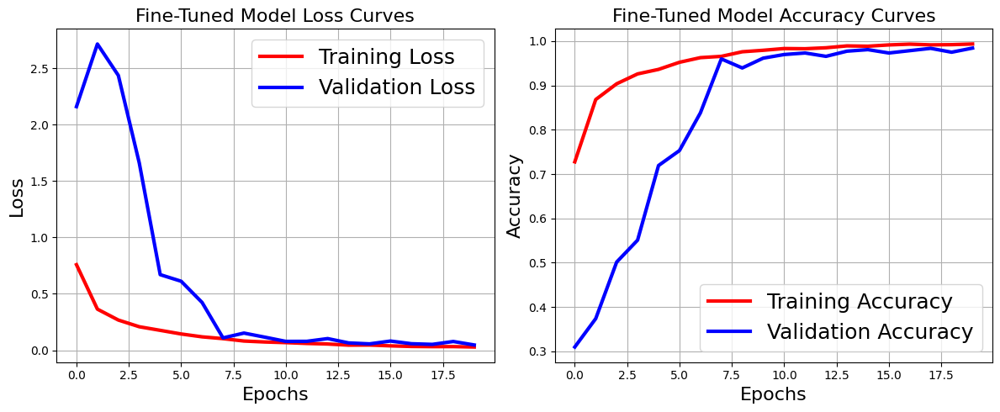

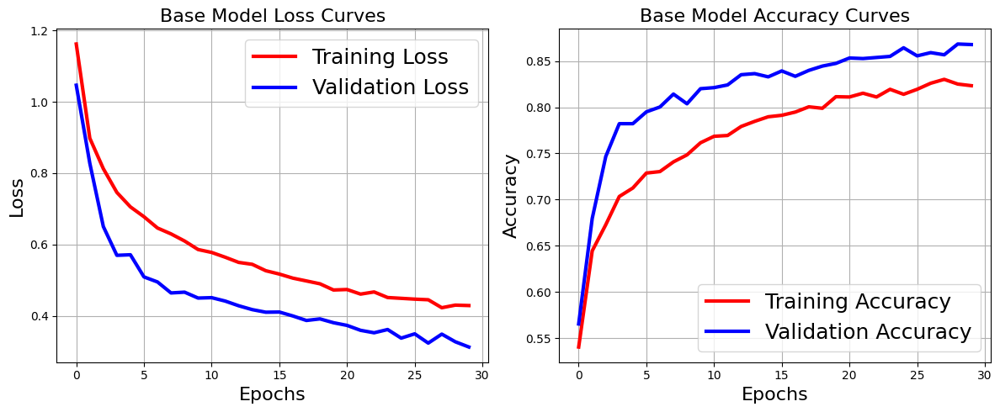

In [ ]:
# Load history from the pickle file
history_base_pkl = "history_base.pkl"
history_fine_tuned_pkl = "history_ft.pkl"
with open(history_fine_tuned_pkl, 'rb') as f:
    history_fine_tuned = pickle.load(f)
with open(history_base_pkl, 'rb') as f:
    base_history = pickle.load(f)
# Plot fine-tuned model the Loss Curves
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(history_fine_tuned['loss'], 'r', linewidth=3.0)
plt.plot(history_fine_tuned['val_loss'], 'b', linewidth=3.0)
plt.legend(['Training Loss', 'Validation Loss'], fontsize=18)
plt.xlabel('Epochs', fontsize=16)
plt.ylabel('Loss', fontsize=16)
plt.title('Fine-Tuned Model Loss Curves', fontsize=16)
plt.grid(True)


# Plot fine-tuned model the Accuracy Curves
plt.subplot(1, 2, 2)
plt.plot(history_fine_tuned['accuracy'], 'r', linewidth=3.0)
plt.plot(history_fine_tuned['val_accuracy'], 'b', linewidth=3.0)
plt.legend(['Training Accuracy', 'Validation Accuracy'], fontsize=18)
plt.xlabel('Epochs', fontsize=16)
plt.ylabel('Accuracy', fontsize=16)
plt.title('Fine-Tuned Model Accuracy Curves', fontsize=16)
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot base the Loss Curves
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(base_history['loss'], 'r', linewidth=3.0)
plt.plot(base_history['val_loss'], 'b', linewidth=3.0)
plt.legend(['Training Loss', 'Validation Loss'], fontsize=18)
plt.xlabel('Epochs', fontsize=16)
plt.ylabel('Loss', fontsize=16)
plt.title('Base Model Loss Curves', fontsize=16)
plt.grid(True)


# Plot base the Accuracy Curves
plt.subplot(1, 2, 2)
plt.plot(base_history['accuracy'], 'r', linewidth=3.0)
plt.plot(base_history['val_accuracy'], 'b', linewidth=3.0)
plt.legend(['Training Accuracy', 'Validation Accuracy'], fontsize=18)
plt.xlabel('Epochs', fontsize=16)
plt.ylabel('Accuracy', fontsize=16)
plt.title('Base Model Accuracy Curves', fontsize=16)
plt.grid(True)
plt.tight_layout()
plt.show()

/usr/local/lib/python3.11/dist-packages/keras/src/saving/saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'rmsprop', because it has 224 variables whereas the saved optimizer has 446 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


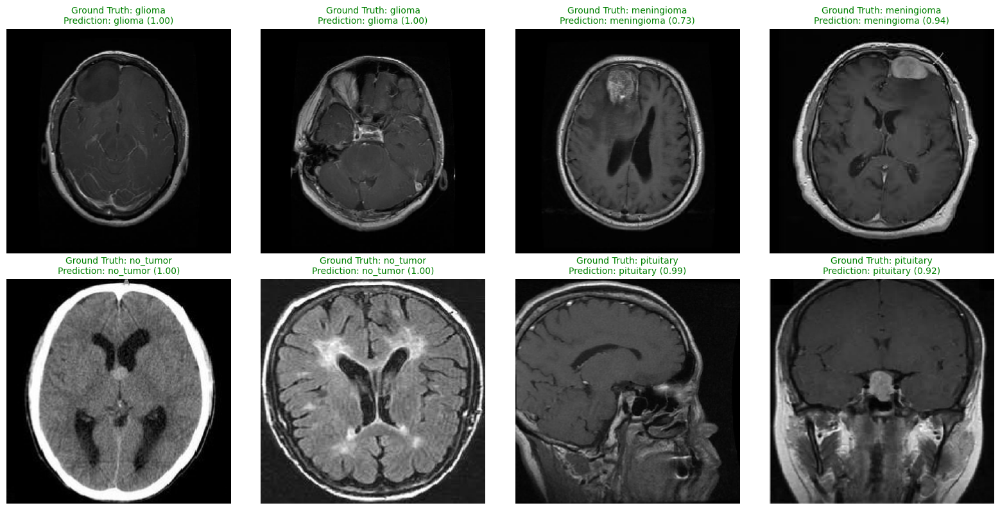

In [ ]:
from tensorflow.keras.preprocessing import image
from sklearn.preprocessing import LabelEncoder
import math
MODEL_PATH = "fine_tuned_model.keras"
IMG_SIZE = (224, 224)
CLASS_NAMES = ['glioma', 'meningioma', 'no_tumor', 'pituitary']

true_labels = [
    'glioma',
    'glioma',
    'meningioma',
    'meningioma',
    'no_tumor',
    'no_tumor',
    'pituitary',
    'pituitary'
]

images = [
    '/content/drive/MyDrive/Colab Notebooks/brain_tumor_dataset/data/Testing/glioma/Te-gl_0033.jpg', #gioma
    '/content/drive/MyDrive/Colab Notebooks/brain_tumor_dataset/data/Testing/glioma/Te-gl_0092.jpg', #gioma
    '/content/drive/MyDrive/Colab Notebooks/brain_tumor_dataset/data/Testing/meningioma/Te-me_0124.jpg', #meningioma
    '/content/drive/MyDrive/Colab Notebooks/brain_tumor_dataset/data/Testing/meningioma/Te-me_0145.jpg', #meningioma
    '/content/drive/MyDrive/Colab Notebooks/brain_tumor_dataset/data/Testing/notumor/image(43).jpg', #no_tumor
    '/content/drive/MyDrive/Colab Notebooks/brain_tumor_dataset/data/Testing/notumor/Te-no_0396.jpg', #no_tumor
    '/content/drive/MyDrive/Colab Notebooks/brain_tumor_dataset/data/Testing/pituitary/Te-pi_0289.jpg',#pituitary
    '/content/drive/MyDrive/Colab Notebooks/brain_tumor_dataset/data/Testing/pituitary/image(66).jpg' #pituitary
]
GRID_COLS = 4
# ------------------

# Load model
model = tf.keras.models.load_model(MODEL_PATH)

# Label encoder
le = LabelEncoder()
le.fit(CLASS_NAMES)

# Image preprocessing
def preprocess_img(img_path):
    img = image.load_img(img_path, target_size=IMG_SIZE)
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    return img_array / 255.0

# Predict all and collect
results = []
for img_path, true_label in zip(images, true_labels):
    try:
        img_array = preprocess_img(img_path)
        preds = model.predict(img_array, verbose=0)[0]
        pred_idx = np.argmax(preds)
        confidence = preds[pred_idx]
        predicted_label = CLASS_NAMES[pred_idx]
        img_display = image.load_img(img_path, target_size=IMG_SIZE)
        results.append((img_display, true_label, predicted_label, confidence))
    except Exception as e:
        print(f" Failed on {img_path}: {e}")

# ----- Display in Grid -----
num_images = len(results)
rows = math.ceil(num_images / GRID_COLS)
plt.figure(figsize=(GRID_COLS * 4, rows * 4))

for idx, (img, true_label, pred_label, conf) in enumerate(results):
    plt.subplot(rows, GRID_COLS, idx + 1)
    plt.imshow(img)
    title_color = 'green' if true_label == pred_label else 'red'
    plt.title(f"Ground Truth: {true_label}\nPrediction: {pred_label} ({conf:.2f})", color=title_color, fontsize=10)
    plt.axis('off')

plt.tight_layout()
plt.show()


In [13]:
!pip install gradio --quiet


In [14]:
import gradio as gr
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image


In [15]:
class_names = ['Glioma Tumor', 'Meningioma Tumor', 'No Tumor', 'Pituitary Tumor']

model = tf.keras.models.load_model('fine_tuned_model.keras')


/usr/local/lib/python3.11/dist-packages/keras/src/saving/saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'rmsprop', because it has 224 variables whereas the saved optimizer has 446 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


In [16]:
def preprocess_image(image):
    image = image.convert("RGB")
    image = image.resize((224, 224))
    image = np.array(image) / 255.0
    image = np.expand_dims(image, axis=0)
    return image


In [17]:
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]

    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

def save_and_display_gradcam(image, heatmap, alpha=0.5):
    image = np.array(image.resize((224, 224)))
    heatmap = cv2.resize(heatmap, (image.shape[1], image.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap_color = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed_img = heatmap_color * alpha + image
    superimposed_img = np.uint8(superimposed_img)
    return Image.fromarray(superimposed_img)


In [18]:
import io

def predict_and_visualize(image):
    try:
        processed = preprocess_image(image)
        prediction = model.predict(processed)[0]
        result = {class_names[i]: float(prediction[i]) for i in range(len(class_names))}

        # Get predicted class label
        predicted_index = np.argmax(prediction)
        predicted_class = class_names[predicted_index]

        if predicted_class == "No Tumor":
            # Show original image if no tumor
            gradcam_result = image.resize((224, 224))
        else:
            # Generate Grad-CAM
            last_conv_layer = 'conv5_block3_out'
            heatmap = make_gradcam_heatmap(processed, model, last_conv_layer, pred_index=predicted_index)
            gradcam_result = save_and_display_gradcam(image, heatmap)

        return result, gradcam_result
    except Exception as e:
        return {"Error": str(e)}, None


In [19]:
with gr.Blocks(css="#submit-btn {background-color: gold; color: black; font-weight: bold;}") as brain_tumor_ui:
    gr.Markdown("<h1 style='text-align: center;'>Brain Tumor MRI Classifier with Grad-CAM</h1>")
    gr.Markdown("Upload an <b>MRI brain scan</b> to classify the presence and type of brain tumor.")

    with gr.Row():
        # LEFT COLUMN: image + submit + confidence
        with gr.Column():
            input_image = gr.Image(type="pil", label="Upload Brain MRI")
            submit_button = gr.Button("Submit", elem_id="submit-btn")
        # RIGHT COLUMN: prediction + Grad-CAM
        with gr.Column():
            prediction_label = gr.Label(label="Prediction")
            gradcam_image = gr.Image(type="pil", label="Grad-CAM Heatmap")

    submit_button.click(fn=predict_and_visualize,
                        inputs=input_image,
                        outputs=[prediction_label, gradcam_image])

brain_tumor_ui.launch(share=True)


Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
* Running on public URL: https://d2761ae98ed258fd28.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)
